## 0. Installations

In [ ]:
# install necessary stuff
!pip install ucimlrepo
!pip install ydata-profiling
!pip install plotly
!pip install dtreeviz
!apt install msttcorefonts -qq
!apt install supertree
!rm ~/.cache/matplotlib -rf

ttf-mscorefonts-installer is already the newest version (3.8ubuntu2).
0 upgraded, 0 newly installed, 0 to remove and 38 not upgraded.
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
graphviz is already the newest version (2.42.2-6ubuntu0.1).
0 upgraded, 0 newly installed, 0 to remove and 38 not upgraded.


## 1. Exploratory data analysis

In this section, we can analyse dataset that we have, perform some data cleaning and analysis.

In [ ]:
from ucimlrepo import fetch_ucirepo

# fetch dataset
cardiotocography = fetch_ucirepo(id=193)

# data (as pandas dataframes)
X = cardiotocography.data.features
y = cardiotocography.data.targets

# metadata
print(cardiotocography.metadata)

# variable information
print(cardiotocography.variables)

{'uci_id': 193, 'name': 'Cardiotocography', 'repository_url': 'https://archive.ics.uci.edu/dataset/193/cardiotocography', 'data_url': 'https://archive.ics.uci.edu/static/public/193/data.csv', 'abstract': 'The dataset consists of measurements of fetal heart rate (FHR) and uterine contraction (UC) features on cardiotocograms classified by expert obstetricians.', 'area': 'Health and Medicine', 'tasks': ['Classification'], 'characteristics': ['Multivariate'], 'num_instances': 2126, 'num_features': 21, 'feature_types': ['Real'], 'demographics': [], 'target_col': ['CLASS', 'NSP'], 'index_col': None, 'has_missing_values': 'no', 'missing_values_symbol': None, 'year_of_dataset_creation': 2000, 'last_updated': 'Fri Mar 15 2024', 'dataset_doi': '10.24432/C51S4N', 'creators': ['D. Campos', 'J. Bernardes'], 'intro_paper': None, 'additional_info': {'summary': '2126 fetal cardiotocograms (CTGs) were automatically processed and the respective diagnostic features measured. The CTGs were also classified

The dataset has provided us with two split dataframes `X` and `y`, which are the features (ie. the data we will use to predict) and the targets (the actual outcome we want to predict) respectively.

We will concatenate these two dataframes into a single dataframe for further analysis.

In [ ]:
# take a look at the features dataframe
X.head(1)

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,...,Width,Min,Max,Nmax,Nzeros,Mode,Mean,Median,Variance,Tendency
0,120,0.0,0.0,0.0,0.0,0.0,0.0,73,0.5,43,...,64,62,126,2,0,120,137,121,73,1


In [ ]:
# target dataframe
y.head(1)

,CLASS,NSP
0,9,2


In [ ]:
# lets merge the features and targets into a dataframe for easy viewing

import pandas as pd

df = pd.concat([X, y], axis=1)

In [ ]:
df.head(1)

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,...,Max,Nmax,Nzeros,Mode,Mean,Median,Variance,Tendency,CLASS,NSP
0,120,0.0,0.0,0.0,0.0,0.0,0.0,73,0.5,43,...,126,2,0,120,137,121,73,1,9,2


In [ ]:
# drop the CLASS column since it is not needed
df = df.drop(columns=['CLASS'])

Now, we have a dataset that we can work with. Our target is the `NSP` column which our model should aim to predict.

In [ ]:
df.head(1)

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,...,Min,Max,Nmax,Nzeros,Mode,Mean,Median,Variance,Tendency,NSP
0,120,0.0,0.0,0.0,0.0,0.0,0.0,73,0.5,43,...,62,126,2,0,120,137,121,73,1,2


In [ ]:
# check for null
print(df.isnull().sum())
assert df.isnull().sum().sum() == 0

LB          0
AC          0
FM          0
UC          0
DL          0
DS          0
DP          0
ASTV        0
MSTV        0
ALTV        0
MLTV        0
Width       0
Min         0
Max         0
Nmax        0
Nzeros      0
Mode        0
Mean        0
Median      0
Variance    0
Tendency    0
NSP         0
dtype: int64


In [ ]:
# drop all duplicates

df = df.drop_duplicates()
df.shape

(2113, 22)

To visualise how the data looks, we can use some tools:

This library helps us easily see which columns are imbalanced, have missing values, or have high correlation, etc.

- Need to rebalance underrepresented classes
- Drop columns that are highly correlated
- See which columns we can further engineer

In [ ]:
from ydata_profiling import ProfileReport

report = ProfileReport(df)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 22/22 [00:00<00:00, 64.13it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### 1.1 Analysis of columns

The dataset contains the following columns:

- `LB` - baseline heart rate
- `AC` - accelerations
- `FM` - fetal movements
- `UC` - uterine contractions
- `DL` - light decelerations
- `DS` - severe decelerations
- `DP` - prolonged decelerations
- `ASTV` - % of time with abnormal short-term variability
- `ALTV` - % of time with abnormal long-term variability
- `MLTV` - mean value of long-term variability
- `MSTV` - mean value of short-term variability
- `Width` - width of FHR histogram
- `Min` - minimum of FHR histogram
- `Max` - Maximum of FHR histogram
- `Nmax` - # of histogram peaks
- `Nzeros` - # of histogram zeros
- `Mode` - histogram mode
- `Mean` - histogram mean
- `Median` - histogram median
- `Variance` - histogram variance
- `Tendency` - histogram tendency (-1=left asymmetric; 0=symmetric; 1=right asymmetric)
- `NSP` - fetal state class code (N=normal; S=suspect; P=pathologic)

There is a rather large class imbalance in the dataset where healthy CTG cases (NSP = 1) has the most occurence while pathological cases (NSP = 3) has the least.

In [ ]:
import plotly.express as px

fig = px.bar(df['NSP'].value_counts().sort_index())
fig.show()

In [ ]:
fig = px.scatter(df, x='MSTV', y='ALTV', title='MSTV vs ALTV', color='NSP')
fig.show()

# observations: high ALTV, low MSTV leads to either 2/3
# NSP=3 observed for highest ALTV

In [ ]:
fig = px.scatter(df, x='MSTV', y='ASTV', title='MSTV vs ASTV', color='NSP')
fig.show()

# observations: high ASTV, low MSTV leads to tendency of NSP=2
# moderate ASTV, high MSTV leads to tendency of NSP=3

In [ ]:
fig = px.box(df, x='NSP', y='LB', title='Distribution of LB by NSP')
fig.show()

In [ ]:
fig = px.scatter(df, x='LB', y='Mean', color='NSP', title="LB vs Mean")
fig.show()

In [ ]:
fig = px.scatter(df, x='Width', y='Variance', color='NSP', title="Width vs Variance")
fig.show()

In [ ]:
fig = px.scatter(df, x='Mean', y='Variance', title='Mean vs Variance', color='NSP')
fig.show()

### 1.2 Primary Analysis

Summary

- LB vs Mean: Lower LBs and lower Mean tends to be associated with pathological cases (NSP = 3) while higher LBs and higher Mean tends to be a mix of healthy (NSP = 1) and suspect (NSP = 2) cases.
- Width vs Variance: Higher widths & variance tend to be associated with pathological cases (NSP = 3).
- MSTV vs ALTV: Lower MSTV and higher ALTV tends towards suspect (NSP = 2) and pathological cases (NSP = 3).
- Mean vs Variance: Low Mean tends to pathological cases (NSP = 3) quite clear separation while higher Mean tends to suggest cases (NSP = 2).

From the findings above, there are a few issues:

1. The `DS` column only has two unique values, either `0` or `0.001`
2. The classes we want to predict `NSP`, is imbalanced: 1655 `1`, 295 `2`, 176 `3`
3. Columns like `DS`, `DP`, `DL`, `FM`, `ALTV`, `Nzeros` have very high % of zero values

## 2. Baseline model

Before we continue with feature engineering and other data transformations, we will train a few simple models so that we have a baseline to compare our final model with.

1. Logistic regression
2. SVM
3. Random forest
4. Neural networks

For simplicity and demonstration purposes, we use default arguments for all models, hyperparameter tuning will be done later so we can see how much our models improve.

In [ ]:
# before we continue, it is good to define a helper function that will help us evaluate our model
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report, balanced_accuracy_score

def evaluate_model(model, X_test, y_test):
    # Make predictions on the test set
    y_pred = model.predict(X_test)

    # Evaluate the model
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    f1_macro = f1_score(y_test, y_pred, average='macro')
    balanced_acc = balanced_accuracy_score(y_test, y_pred)

    print(f"Accuracy: {accuracy:.4f}")
    print(f"Precision (weighted): {precision:.4f}")
    print(f"Recall (weighted): {recall:.4f}")
    print(f"F1-score (macro): {f1_macro:.4f}")
    print(f"Balanced Accuracy: {balanced_acc:.4f}")

    print(classification_report(y_test, y_pred))

### 2.1 Logistic Regression

For a fair test, we performed a stratified split to ensure that our training and test sets maintain the same proportion of each class.

In [ ]:
from sklearn.model_selection import train_test_split

# Define features (X) and target (y)
X = df.drop('NSP', axis=1)
y = df['NSP']

# Split data into a 20/80 train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=80, stratify=y)

print("Training set shape:", X_train.shape)
print("Testing set shape:", X_test.shape)

Training set shape: (1690, 21)
Testing set shape: (423, 21)


In [ ]:
# Train the Logistic Regression model
from sklearn.linear_model import LogisticRegression

lr = LogisticRegression()
lr.fit(X_train, y_train)
evaluate_model(lr, X_test, y_test)

### 2.2 SVM

In [ ]:
from sklearn.svm import SVC

# Initialize the SVM model
svm = SVC()

# Train the SVM model
svm.fit(X_train, y_train)
evaluate_model(svm, X_test, y_test)

Accuracy: 0.8369
Precision (weighted): 0.8176
Recall (weighted): 0.8369
F1-score (macro): 0.6354
Balanced Accuracy: 0.5876
              precision    recall  f1-score   support

           1       0.88      0.97      0.92       330
           2       0.45      0.31      0.37        58
           3       0.85      0.49      0.62        35

    accuracy                           0.84       423
   macro avg       0.73      0.59      0.64       423
weighted avg       0.82      0.84      0.82       423



### 2.3 Random forest

In [ ]:
from sklearn.ensemble import RandomForestClassifier

# Initialize the Random Forest model
rf = RandomForestClassifier(random_state=80)

# Train the Random Forest model
rf.fit(X_train, y_train)
evaluate_model(rf, X_test, y_test)

Accuracy: 0.9456
Precision (weighted): 0.9444
Recall (weighted): 0.9456
F1-score (macro): 0.9041
Balanced Accuracy: 0.8811
              precision    recall  f1-score   support

           1       0.96      0.98      0.97       330
           2       0.87      0.78      0.82        58
           3       0.97      0.89      0.93        35

    accuracy                           0.95       423
   macro avg       0.93      0.88      0.90       423
weighted avg       0.94      0.95      0.94       423



### 2.4 Neural network

In [ ]:
from sklearn.neural_network import MLPClassifier

mlp = MLPClassifier()

mlp.fit(X_train, y_train)
evaluate_model(mlp, X_test, y_test)

Accuracy: 0.8605
Precision (weighted): 0.8517
Recall (weighted): 0.8605
F1-score (macro): 0.7375
Balanced Accuracy: 0.7132
              precision    recall  f1-score   support

           1       0.90      0.94      0.92       330
           2       0.60      0.48      0.53        58
           3       0.81      0.71      0.76        35

    accuracy                           0.86       423
   macro avg       0.77      0.71      0.74       423
weighted avg       0.85      0.86      0.85       423



So far, it looks like tree methods result in the best accuracy. To confirm this, we will try other tree-based methods such as LightGBM and XGBoost.

In [ ]:
from lightgbm import LGBMClassifier

lgbm = LGBMClassifier(
    random_state=80
)

lgbm.fit(X_train, y_train)
evaluate_model(lgbm, X_test, y_test)

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000500 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1211
[LightGBM] [Info] Number of data points in the train set: 1690, number of used features: 20
[LightGBM] [Info] Start training from score -0.250132
[LightGBM] [Info] Start training from score -1.977163
[LightGBM] [Info] Start training from score -2.490841
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Accuracy: 0.9551
Precision (weighted): 0.9548
Recall (weighted): 0.9551
F1-score (macro): 0.9178
Balanced Accuracy: 0.9041
              precision    recall  f1-score   support

           1       0.97      0.98      0.98       330
           2       0.86      0.84      0.85        58
           3       0.97      0.89      0.93       

In [ ]:
from xgboost import XGBClassifier

xgb_base = XGBClassifier(random_state=80)

# Adjust target values to be 0, 1, and 2 for XGBoost
xgb_base.fit(X_train, y_train - 1)
evaluate_model(xgb_base, X_test, y_test - 1)

Accuracy: 0.9527
Precision (weighted): 0.9527
Recall (weighted): 0.9527
F1-score (macro): 0.9210
Balanced Accuracy: 0.9069
              precision    recall  f1-score   support

           0       0.97      0.98      0.97       330
           1       0.84      0.83      0.83        58
           2       1.00      0.91      0.96        35

    accuracy                           0.95       423
   macro avg       0.94      0.91      0.92       423
weighted avg       0.95      0.95      0.95       423



Tree-based models consistently outperform other methods, even deep learning methods. Hence, our group's focus will be on tree-based models.

Especially since our data is tabular, decision tree algorithms provide explainability as compared to black-box deep learning methods.

The dataset is already pretty clean, so we get quite good results with LightGBM/XGBoost which can potentially be improved further with some hyperparameter tuning/feature engineering.

From the results, we notice that Recall is quite low for classes 2/3 which is a concern. For models that are used to predict outcomes related to health, it is better to prioritise higher Recall: ie. a lower number of False Negatives in comparison to True Positives. This is because a missed diagnosis could have severe consequences for patients as their condition might worsen as a result of a delayed diagnosis.

## 3. Feature engineering

In this section, we will explore how we can transform our dataset features to improve the accuracy of our models

Lets create a new column, `DS_present`, which indicates whether a severe deceleration is present since there are only two distinct values in the dataset.

In [ ]:
df_DS_present = df[df['DS'] > 0]

In [ ]:
df_DS_present[['DS', 'NSP']]

,DS,NSP
1488,0.001,1
1489,0.001,3
1791,0.001,3
1792,0.001,3
1793,0.001,3
1794,0.001,3
1795,0.001,3


Out of the 7 entries in our dataset with a `DS` larger than 0, almost all of them correspond to the outcome `NSP=3`. This means that the presence of `DS` is likely a good indicator on the outcome of the diagnosis. Therefore, it makes sense to include an indicator column `DS_present`.

In [ ]:
df['DS_present'] = (df['DS'] > 0).astype(int)
df.head()

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,...,Max,Nmax,Nzeros,Mode,Mean,Median,Variance,Tendency,NSP,DS_present
0,120,0.000,0.0,0.000,0.000,0.0,0.0,73,0.5,43,...,126,2,0,120,137,121,73,1,2,0
1,132,0.006,0.0,0.006,0.003,0.0,0.0,17,2.1,0,...,198,6,1,141,136,140,12,0,1,0
2,133,0.003,0.0,0.008,0.003,0.0,0.0,16,2.1,0,...,198,5,1,141,135,138,13,0,1,0
3,134,0.003,0.0,0.008,0.003,0.0,0.0,16,2.4,0,...,170,11,0,137,134,137,13,1,1,0
4,132,0.007,0.0,0.008,0.000,0.0,0.0,16,2.4,0,...,170,9,0,137,136,138,11,1,1,0


Let's look at other columns with many zero values

In [ ]:
df_DP_present = df[df['DP'] > 0]

Again, it looks like the presence of `DP` also results in a higher plausibility of `NSP=3`. This means that we can also consider having a `DP_present` column.

In [ ]:
df_DP_present['NSP'].value_counts()

,count
NSP,
3,94
1,69
2,15


In [ ]:
df['DP_present'] = (df['DP'] > 0).astype(int)
df.head()

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,...,Nmax,Nzeros,Mode,Mean,Median,Variance,Tendency,NSP,DS_present,DP_present
0,120,0.000,0.0,0.000,0.000,0.0,0.0,73,0.5,43,...,2,0,120,137,121,73,1,2,0,0
1,132,0.006,0.0,0.006,0.003,0.0,0.0,17,2.1,0,...,6,1,141,136,140,12,0,1,0,0
2,133,0.003,0.0,0.008,0.003,0.0,0.0,16,2.1,0,...,5,1,141,135,138,13,0,1,0,0
3,134,0.003,0.0,0.008,0.003,0.0,0.0,16,2.4,0,...,11,0,137,134,137,13,1,1,0,0
4,132,0.007,0.0,0.008,0.000,0.0,0.0,16,2.4,0,...,9,0,137,136,138,11,1,1,0,0


We shall not add presence indicators for the rest of the columns since they are
unlikely to affect the final outcome.

In [ ]:
df.head()

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,...,Nmax,Nzeros,Mode,Mean,Median,Variance,Tendency,NSP,DS_present,DP_present
0,120,0.000,0.0,0.000,0.000,0.0,0.0,73,0.5,43,...,2,0,120,137,121,73,1,2,0,0
1,132,0.006,0.0,0.006,0.003,0.0,0.0,17,2.1,0,...,6,1,141,136,140,12,0,1,0,0
2,133,0.003,0.0,0.008,0.003,0.0,0.0,16,2.1,0,...,5,1,141,135,138,13,0,1,0,0
3,134,0.003,0.0,0.008,0.003,0.0,0.0,16,2.4,0,...,11,0,137,134,137,13,1,1,0,0
4,132,0.007,0.0,0.008,0.000,0.0,0.0,16,2.4,0,...,9,0,137,136,138,11,1,1,0,0


A hypothesis is that the presence of decelerations result in a higher likelihood to be diagnosed with either `NSP=2/3`. Therefore, we can calculate a **deceleration severity score**,

$ S = DL + 3.5 * DP + 5 * DS $

where $S$ is the weighted sum of `DL`, `DP` and `DS`. A higher weightage is given to `DS`.

In [ ]:
def calculate_deceleration_score(row):
  """Calculates the deceleration severity score for a row."""
  return row['DL'] + 3.5 * row['DP'] + 5 * row['DS']

df['Deceleration_Score'] = df.apply(calculate_deceleration_score, axis=1)
display(df.head())

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,...,Nzeros,Mode,Mean,Median,Variance,Tendency,NSP,DS_present,DP_present,Deceleration_Score
0,120,0.000,0.0,0.000,0.000,0.0,0.0,73,0.5,43,...,0,120,137,121,73,1,2,0,0,0.000
1,132,0.006,0.0,0.006,0.003,0.0,0.0,17,2.1,0,...,1,141,136,140,12,0,1,0,0,0.003
2,133,0.003,0.0,0.008,0.003,0.0,0.0,16,2.1,0,...,1,141,135,138,13,0,1,0,0,0.003
3,134,0.003,0.0,0.008,0.003,0.0,0.0,16,2.4,0,...,0,137,134,137,13,1,1,0,0,0.003
4,132,0.007,0.0,0.008,0.000,0.0,0.0,16,2.4,0,...,0,137,136,138,11,1,1,0,0,0.000


Next, we will handle the histogram features `Min, Max, Median, Mean, Mode, Variance, Width`.

All these features are likely relative to the basal heart rate, so we should standardise the entire column.

For the `Mode` and `Median` columns, we calculate the `Z_mode` and `Z_median` using the z-score formula,

$$z = \dfrac{x-\mu}{\sigma}$$

where $x$ represents the original values for mode and median, $\mu$ is the mean, and $\sigma$ is the standard deviation.

Earlier above in our plots, we noticed that in the `Mean vs Variance` scatterplot, outcomes of NSP=3 usually have low Mean, while outcomes of NSP=2 has high Mean and low Variance. Therefore, we can calculate the variance-to-mean ratio, ie. [index of dispersion](https://en.wikipedia.org/wiki/Index_of_dispersion), given by:

$$ D = \dfrac{\sigma ^2}{\mu} $$

In [ ]:
import numpy as np

def calculate_z_score(value, mean, std):
  """Calculates the Z-score for a given value."""
  # Avoid division by zero
  if std == 0:
    return 0
  return (value - mean) / std

def calculate_vmr(mean, var):
  """Calculates the coefficient of variance."""
  # Avoid division by zero
  if mean == 0:
    return 0
  return var / mean


# Calculate Z-scores and CV
df['Z_Mode'] = df.apply(lambda row: calculate_z_score(row['Mode'], row['Mean'], np.sqrt(row['Variance'])), axis=1)
df['Z_Median'] = df.apply(lambda row: calculate_z_score(row['Median'], row['Mean'], np.sqrt(row['Variance'])), axis=1)
df['VMR'] = df.apply(lambda row: calculate_vmr(row['Mean'], row['Variance']), axis=1)
display(df.head())

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,...,Median,Variance,Tendency,NSP,DS_present,DP_present,Deceleration_Score,Z_Mode,Z_Median,VMR
0,120,0.000,0.0,0.000,0.000,0.0,0.0,73,0.5,43,...,121,73,1,2,0,0,0.000,-1.989700,-1.872658,0.532847
1,132,0.006,0.0,0.006,0.003,0.0,0.0,17,2.1,0,...,140,12,0,1,0,0,0.003,1.443376,1.154701,0.088235
2,133,0.003,0.0,0.008,0.003,0.0,0.0,16,2.1,0,...,138,13,0,1,0,0,0.003,1.664101,0.832050,0.096296
3,134,0.003,0.0,0.008,0.003,0.0,0.0,16,2.4,0,...,137,13,1,1,0,0,0.003,0.832050,0.832050,0.097015
4,132,0.007,0.0,0.008,0.000,0.0,0.0,16,2.4,0,...,138,11,1,1,0,0,0.000,0.301511,0.603023,0.080882


We can also further add some details related to the `Min` and `Max` columns, given that they tell us the minimum and maximum heart rate achieved. We can compare this to the `LB` baseline heart rate, so we can hopefully see how much the heart rate deviates.

Lets define `mean_dev`, `max_dev` and `min_dev`:

In [ ]:
def calculate_deviation(value, baseline):
  """Calculates the deviation from the baseline heart rate."""
  return value - baseline

df['Mean_Dev'] = df.apply(lambda row: calculate_deviation(row['Mean'], row['LB']), axis=1)
df['Max_Dev'] = df.apply(lambda row: calculate_deviation(row['Max'], row['LB']), axis=1)
df['Min_Dev'] = df.apply(lambda row: calculate_deviation(row['Min'], row['LB']), axis=1)

display(df.head())

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,...,NSP,DS_present,DP_present,Deceleration_Score,Z_Mode,Z_Median,VMR,Mean_Dev,Max_Dev,Min_Dev
0,120,0.000,0.0,0.000,0.000,0.0,0.0,73,0.5,43,...,2,0,0,0.000,-1.989700,-1.872658,0.532847,17.0,6.0,-58.0
1,132,0.006,0.0,0.006,0.003,0.0,0.0,17,2.1,0,...,1,0,0,0.003,1.443376,1.154701,0.088235,4.0,66.0,-64.0
2,133,0.003,0.0,0.008,0.003,0.0,0.0,16,2.1,0,...,1,0,0,0.003,1.664101,0.832050,0.096296,2.0,65.0,-65.0
3,134,0.003,0.0,0.008,0.003,0.0,0.0,16,2.4,0,...,1,0,0,0.003,0.832050,0.832050,0.097015,0.0,36.0,-81.0
4,132,0.007,0.0,0.008,0.000,0.0,0.0,16,2.4,0,...,1,0,0,0.000,0.301511,0.603023,0.080882,4.0,38.0,-79.0


## 4. Training

Once we have our augmented dataset, it is time to train. We will define a 80/20 train/test stratified split, withholding the test set to avoid data leakage.

As mentioned above, we perform a stratified split. To address the class imbalance, we will use class weights, which assigns different importance to each class based on the size of the class. Minority classes are assigned a higher weight, which will help the model to learn better for underrepresented classes.

This will address the problem we saw earlier that while the accuracy for the Normal class is very high, the accuracy for the other classes are much lower.

We will try three models:
1. Random Forest
2. LightGBM
3. XGBoost

In [ ]:
from sklearn.model_selection import StratifiedKFold, cross_validate, train_test_split
from sklearn.metrics import make_scorer, balanced_accuracy_score, f1_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.utils.class_weight import compute_class_weight, compute_sample_weight
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier

classes = np.unique(y_train.values)
cw = compute_class_weight(class_weight='balanced', classes=classes, y=y_train.values)
class_weight_dict = dict(zip(classes, cw))

sample_weight = compute_sample_weight(class_weight='balanced', y=y_train.values)

In [ ]:
feature_columns = [col for col in df.columns if col != "NSP"]
X = df[feature_columns].copy()
y = df['NSP'].copy()

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=80, stratify=y)

print("Training set shape:", X_train.shape)
print("Testing set shape:", X_test.shape)

Training set shape: (1690, 30)
Testing set shape: (423, 30)


In [ ]:
# check the sizes of all our splits

print("X_train shape: ", X_train.shape)
print("y_train shape: ", y_train.shape)
print("X_test shape: ", X_test.shape)
print("y_test shape: ", y_test.shape)

X_train shape:  (1690, 30)
y_train shape:  (1690,)
X_test shape:  (423, 30)
y_test shape:  (423,)


In [ ]:
rf_estimator = RandomForestClassifier(random_state=80, class_weight=class_weight_dict)
lgbm_estimator = LGBMClassifier(random_state=80)
xgb = XGBClassifier(random_state=80)

In [ ]:
xgb.fit(X_train, y_train - 1, sample_weight=sample_weight)
rf_estimator.fit(X_train, y_train)
lgbm_estimator.fit(X_train, y_train, sample_weight=sample_weight)

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000245 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2248
[LightGBM] [Info] Number of data points in the train set: 1690, number of used features: 28
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


LGBMClassifier(random_state=80)

In [ ]:
evaluate_model(rf_estimator, X_test, y_test)
evaluate_model(lgbm_estimator, X_test, y_test)
evaluate_model(xgb, X_test, y_test - 1)

Accuracy: 0.9527
Precision (weighted): 0.9517
Recall (weighted): 0.9527
F1-score (macro): 0.9159
Balanced Accuracy: 0.8927
              precision    recall  f1-score   support

           1       0.96      0.99      0.97       330
           2       0.90      0.78      0.83        58
           3       0.97      0.91      0.94        35

    accuracy                           0.95       423
   macro avg       0.94      0.89      0.92       423
weighted avg       0.95      0.95      0.95       423

Accuracy: 0.9645
Precision (weighted): 0.9641
Recall (weighted): 0.9645
F1-score (macro): 0.9308
Balanced Accuracy: 0.9129
              precision    recall  f1-score   support

           1       0.97      0.99      0.98       330
           2       0.91      0.86      0.88        58
           3       0.97      0.89      0.93        35

    accuracy                           0.96       423
   macro avg       0.95      0.91      0.93       423
weighted avg       0.96      0.96      0.96    

## 5. Hyperparameter tuning

Based on the above results, our LightGBM model gives us the best result so far. We will now explore how to achieve a better result by setting some hyperparameters.

In [ ]:
from lightgbm import LGBMClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import make_scorer, f1_score, balanced_accuracy_score

lgbm = LGBMClassifier(
    objective='multiclass',
    num_class=3,
    random_state=80,
    class_weight='balanced',  # handle imbalance automatically
    n_jobs=-1,
    max_depth=31,
    num_leaves=60
)

lgbm.fit(X_train, y_train, sample_weight=sample_weight)
evaluate_model(lgbm, X_test, y_test)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002776 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2248
[LightGBM] [Info] Number of data points in the train set: 1690, number of used features: 28
[LightGBM] [Info] Start training from score -2.774083
[LightGBM] [Info] Start training from score -1.047052
[LightGBM] [Info] Start training from score -0.533374
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

## 6. Explaining our model

We can plot out the top features that our model used to determine the outcome:

<Figure size 800x600 with 0 Axes>

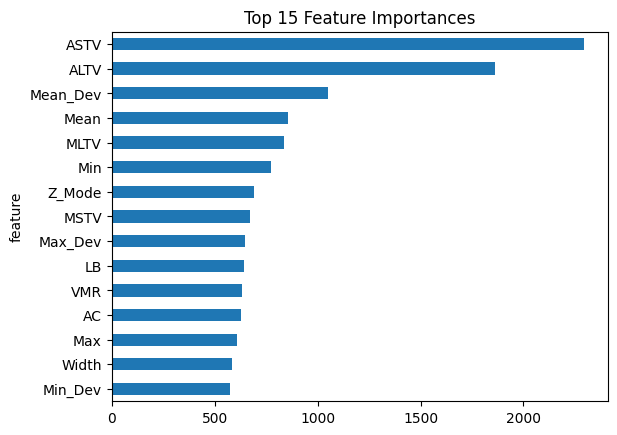

In [ ]:
import lightgbm as lgb
import matplotlib.pyplot as plt
import pandas as pd

# Get feature importances
feature_importances = pd.DataFrame({
    'feature': lgbm.feature_name_,
    'importance': lgbm.feature_importances_
}).sort_values(by='importance', ascending=False)

# Plot top 15
plt.figure(figsize=(8,6))
feature_importances.head(15).plot(kind='barh', x='feature', y='importance', legend=False)
plt.gca().invert_yaxis()
plt.title("Top 15 Feature Importances")
plt.show()

We can also visualise our decision tree using the library `supertree`.

Overall analysis:

- As we increase the depth of our decision tree, we can see how the predicted outcome is determined based on the threshold before the tree splits into more leaf nodes.

- Looking at the ASTV node, we can see that since most of the Pathologic cases have higher ASTV values, the split occurs around ASTV=56.5

- As we click on each node, the depth of the tree increases as it shows the decision process - after looking at ASTV, the model looks as VMR, then Mean Dev, which then terminates with a pie chart showing the distribution of the actual classes.

So the tree visualisation allows us to look into the model's thought process when making a prediction:

Root node: AC, threshold 0.006
- If less than threshold, look at ASTV. Otherwise, look at LB

continue...



In [ ]:
booster = lgbm.booster_

# Define features, target, and class names
features = [col for col in df.columns if col != 'NSP']
target = 'NSP'
class_names = ['Normal', 'Suspect', 'Pathologic']


from supertree import SuperTree

st = SuperTree(
    lgbm,
    X_train,
    y_train,
    features,
    class_names
)
# Visualize the tree
st.show_tree(which_tree=0)

## 7. Submission

To prepare our model for submission, we will now train our model on the full dataset.

Then, we also set up a simple inference pipeline.

In [ ]:
# Retrain the LightGBM model on the full dataset

# Define features (X) and target (y) for the full dataset
feature_columns = [col for col in df.columns if col != "NSP"]
X_full = df[feature_columns].copy()
y_full = df['NSP'].copy()

# Compute sample weights for the full dataset
sample_weight_full = compute_sample_weight(class_weight='balanced', y=y_full.values)

# Initialize the LightGBM model with the chosen hyperparameters
lgbm_final = LGBMClassifier(
    objective='multiclass',
    num_class=3,
    random_state=80,
    class_weight='balanced',  # handle imbalance automatically
    n_jobs=-1,
    max_depth=31,
    num_leaves=60
)

# Train the model on the full dataset
lgbm_final.fit(X_full, y_full, sample_weight=sample_weight_full)

print("Training on entire dataset complete.")
evaluate_model(lgbm_final, X_test, y_test)
# on evaluating with our previously hidden test set, we see that our model can now almost get perfect accuracy since it has "seen" the data already
# this is not indicative of the performance on the final testing set, we should take the previous accuracy instead
# this is just to confirm that we successfully trained on the full dataset

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000393 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2319
[LightGBM] [Info] Number of data points in the train set: 2113, number of used features: 28
[LightGBM] [Info] Start training from score -2.775254
[LightGBM] [Info] Start training from score -1.045904
[LightGBM] [Info] Start training from score -0.533937
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spli

We save the final model `lgbm_final`


In [ ]:
import os
import joblib

# create the models/ directory if it doesn't exist
os.makedirs('models', exist_ok=True)

model_path = os.path.join('models', 'lgbm_final.pkl')

# Save the trained LightGBM model
joblib.dump(lgbm_final, model_path)

print(f"Model saved to {model_path}")

Model saved to models/lgbm_final.pkl


To run inference on our trained model, load the model weights:

In [ ]:
import os
import joblib

model_path = os.path.join('models', 'lgbm_final.pkl')

if os.path.exists(model_path):
    loaded_model = joblib.load(model_path)
    print(f"Model loaded from {model_path}")
else:
    print(f"Model file not found at {model_path}")
    loaded_model = None

Model loaded from models/lgbm_final.pkl


In [ ]:
# define our helper function to do all our feature engineering above
import numpy as np
import pandas as pd
from typing import List

def inference_pipeline(input_df: pd.DataFrame, loaded_model: LGBMClassifier, feature_columns: List[str]) -> pd.Series:
    """
    Applies feature engineering steps and makes predictions using a loaded model.

    Args:
        input_df: Input DataFrame.
        loaded_model: Trained model object.
        feature_columns: List of feature column names used during training.

    Returns:
        A pandas Series containing the predictions.
    """
    processed_df = input_df.copy()

    # Apply feature engineering steps
    processed_df['DS_present'] = (processed_df['DS'] > 0).astype(int)
    processed_df['DP_present'] = (processed_df['DP'] > 0).astype(int)
    processed_df['Deceleration_Score'] = processed_df.apply(calculate_deceleration_score, axis=1)
    processed_df['Z_Mode'] = processed_df.apply(lambda row: calculate_z_score(row['Mode'], row['Mean'], np.sqrt(row['Variance'])), axis=1)
    processed_df['Z_Median'] = processed_df.apply(lambda row: calculate_z_score(row['Median'], row['Mean'], np.sqrt(row['Variance'])), axis=1)
    processed_df['VMR'] = processed_df.apply(lambda row: calculate_vmr(row['Mean'], row['Variance']), axis=1)
    processed_df['Mean_Dev'] = processed_df.apply(lambda row: calculate_deviation(row['Mean'], row['LB']), axis=1)
    processed_df['Max_Dev'] = processed_df.apply(lambda row: calculate_deviation(row['Max'], row['LB']), axis=1)
    processed_df['Min_Dev'] = processed_df.apply(lambda row: calculate_deviation(row['Min'], row['LB']), axis=1)

    # Select the feature columns used during training
    X_processed = processed_df[feature_columns]

    # Make predictions
    predictions = loaded_model.predict(X_processed)

    return predictions

Now, load the evaluation csv into a dataframe for inference:

In [ ]:
# Create a dummy DataFrame for inference
eval_df = pd.read_csv("path/to/eval.csv")

features_df = eval_df.drop(columns=['NSP']).copy()

feature_columns = [col for col in eval_df.columns if col != "NSP"]

# Apply the inference pipeline to get predictions
predictions = inference_pipeline(eval_df, loaded_model, feature_columns)

# Add predictions as a new column
eval_df['Predicted_NSP'] = predictions

# Display the DataFrame with predictions
display(eval_df)

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,...,DS_present,DP_present,Deceleration_Score,Z_Mode,Z_Median,VMR,Mean_Dev,Max_Dev,Min_Dev,Predicted_NSP
0,120,0.000,0.0,0.000,0.000,0.0,0.0,73,0.5,43,...,0,0,0.000,-1.989700,-1.872658,0.532847,17.0,6.0,-58.0,2
1,132,0.006,0.0,0.006,0.003,0.0,0.0,17,2.1,0,...,0,0,0.003,1.443376,1.154701,0.088235,4.0,66.0,-64.0,1
2,133,0.003,0.0,0.008,0.003,0.0,0.0,16,2.1,0,...,0,0,0.003,1.664101,0.832050,0.096296,2.0,65.0,-65.0,1
3,134,0.003,0.0,0.008,0.003,0.0,0.0,16,2.4,0,...,0,0,0.003,0.832050,0.832050,0.097015,0.0,36.0,-81.0,1
4,132,0.007,0.0,0.008,0.000,0.0,0.0,16,2.4,0,...,0,0,0.000,0.301511,0.603023,0.080882,4.0,38.0,-79.0,1


In [ ]:
if 'NSP' in df.columns:
    actual_nsp = df['NSP']
    features_for_evaluation = df.drop('NSP', axis=1)
    print("Evaluating predictions...")
    evaluate_model(loaded_model, features_for_evaluation, actual_nsp)
else:
    print("No ground truth column found for evaluation.")

Evaluating predictions...
Accuracy: 0.9991
Precision (weighted): 0.9991
Recall (weighted): 0.9991
F1-score (macro): 0.9987
Balanced Accuracy: 0.9996
              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1646
           2       0.99      1.00      1.00       292
           3       1.00      1.00      1.00       175

    accuracy                           1.00      2113
   macro avg       1.00      1.00      1.00      2113
weighted avg       1.00      1.00      1.00      2113

